In [1]:
import pandas as pd 
import numpy as np
from sklearn.model_selection import StratifiedKFold
from utils import score_model, plot_result_score_model

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

In [4]:
df = pd.read_csv("winequality-red.csv")

In [5]:
df.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


In [6]:
df.dtypes

fixed acidity           float64
volatile acidity        float64
citric acid             float64
residual sugar          float64
chlorides               float64
free sulfur dioxide     float64
total sulfur dioxide    float64
density                 float64
pH                      float64
sulphates               float64
alcohol                 float64
quality                   int64
dtype: object

In [7]:
df.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000
mean,8.319637,0.527821,0.270976,2.538806,0.087467,15.874922,46.467792,0.996747,3.311113,0.658149,10.422983,5.636023
std,1.741096,0.179060,0.194801,1.409928,0.047065,10.460157,32.895324,0.001887,0.154386,0.169507,1.065668,0.807569
min,4.600000,0.120000,0.000000,0.900000,0.012000,1.000000,6.000000,0.990070,2.740000,0.330000,8.400000,3.000000
25%,7.100000,0.390000,0.090000,1.900000,0.070000,7.000000,22.000000,0.995600,3.210000,0.550000,9.500000,5.000000
50%,7.900000,0.520000,0.260000,2.200000,0.079000,14.000000,38.000000,0.996750,3.310000,0.620000,10.200000,6.000000
75%,9.200000,0.640000,0.420000,2.600000,0.090000,21.000000,62.000000,0.997835,3.400000,0.730000,11.100000,6.000000
max,15.900000,1.580000,1.000000,15.500000,0.611000,72.000000,289.000000,1.003690,4.010000,2.000000,14.900000,8.000000


<AxesSubplot:>

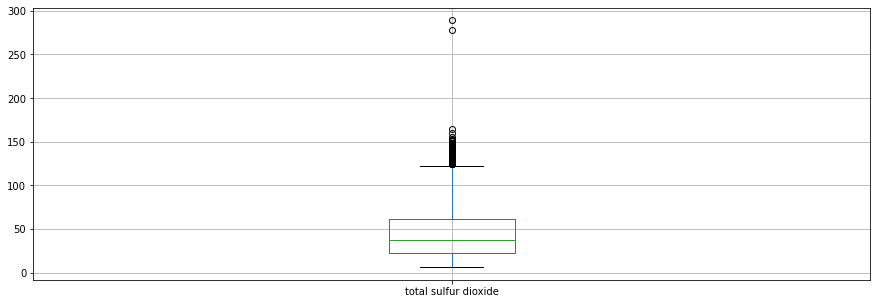

In [8]:
big = ["total sulfur dioxide"]
df[big].boxplot(figsize=(15,5))

<AxesSubplot:>

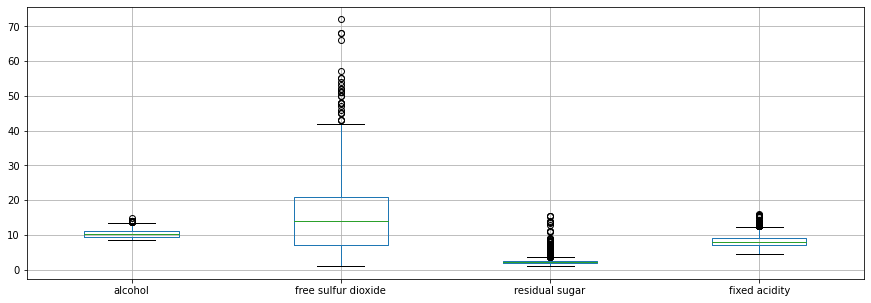

In [9]:
medium = ["alcohol", "free sulfur dioxide", "residual sugar", "fixed acidity" ]
df[medium].boxplot(figsize=(15,5))

<AxesSubplot:>

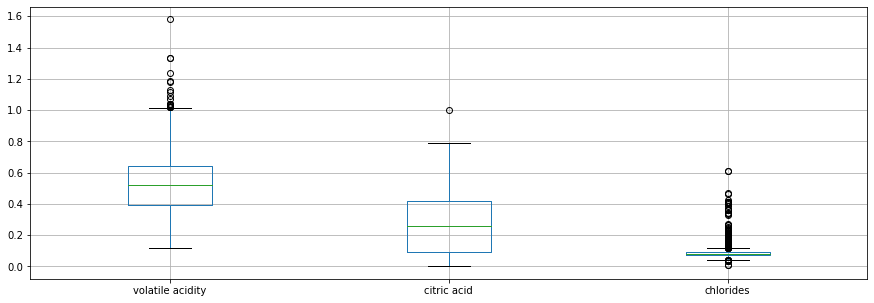

In [10]:
small = [ "volatile acidity", "citric acid", "chlorides" ]
df[small].boxplot(figsize=(15,5))

In [11]:
df.isna().sum()

fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
dtype: int64

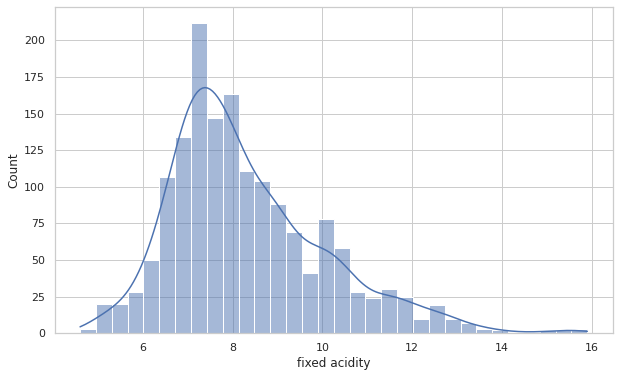

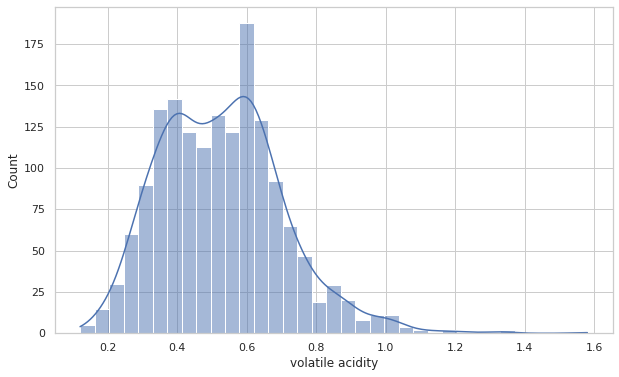

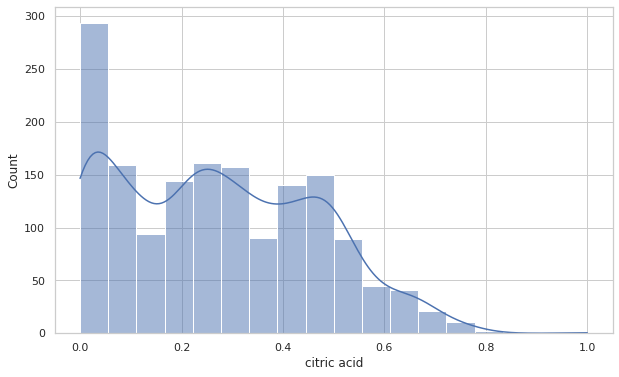

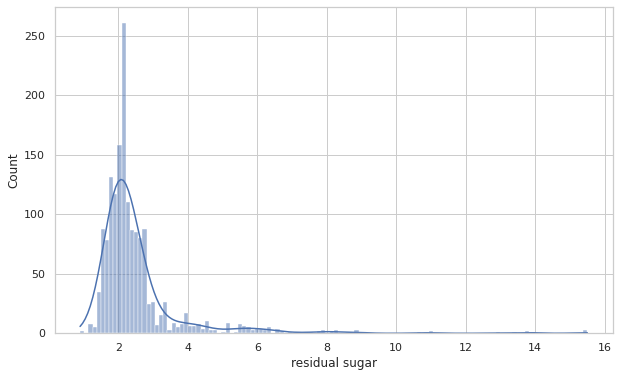

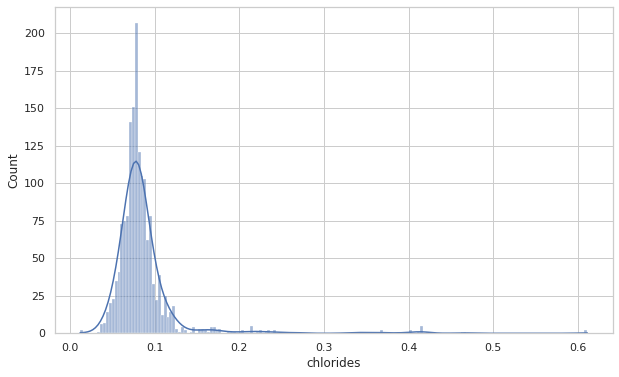

...

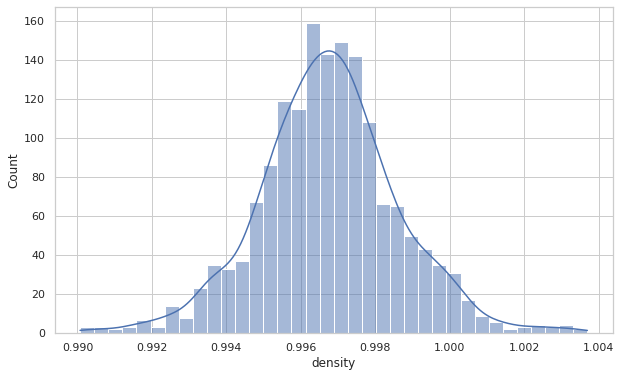

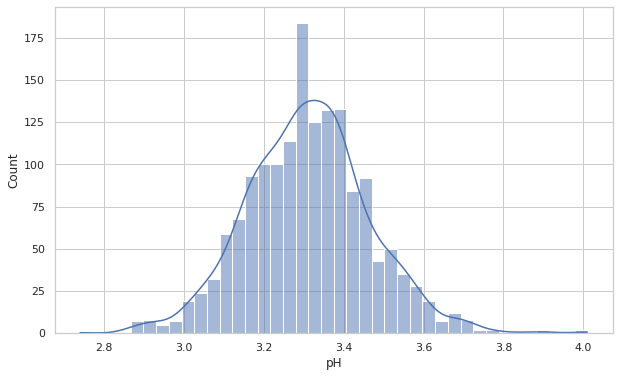

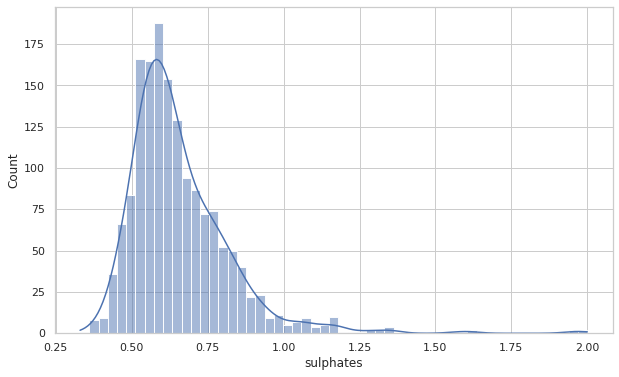

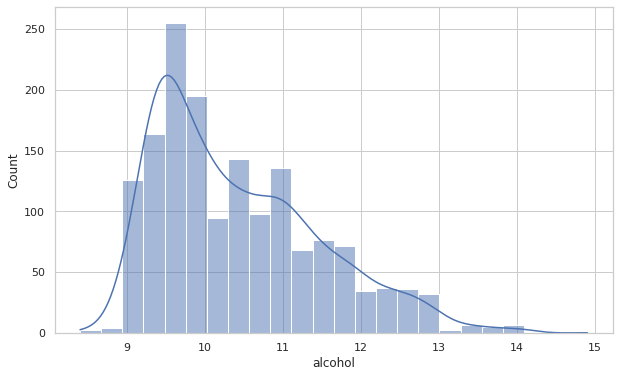

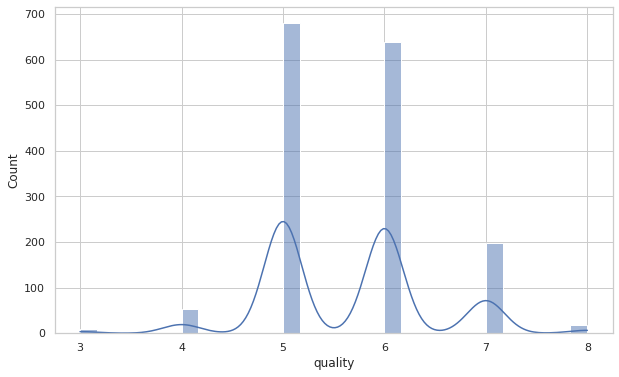

In [12]:

sns.set(style="whitegrid")
for col in df.columns:
    fig = plt.figure(figsize = (10,6))
    sns.histplot(data=df[col], kde=True)

In [13]:
corr = df.corr()

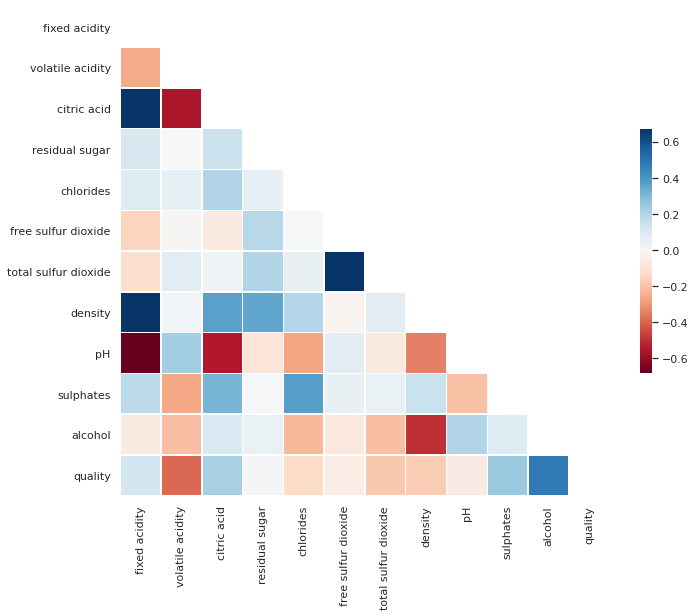

In [14]:
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=np.bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = 'RdBu'

# Draw the heatmap with the mask and correct aspect ratio
sns_plot = sns.heatmap(corr, mask=mask, cmap=cmap, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5})

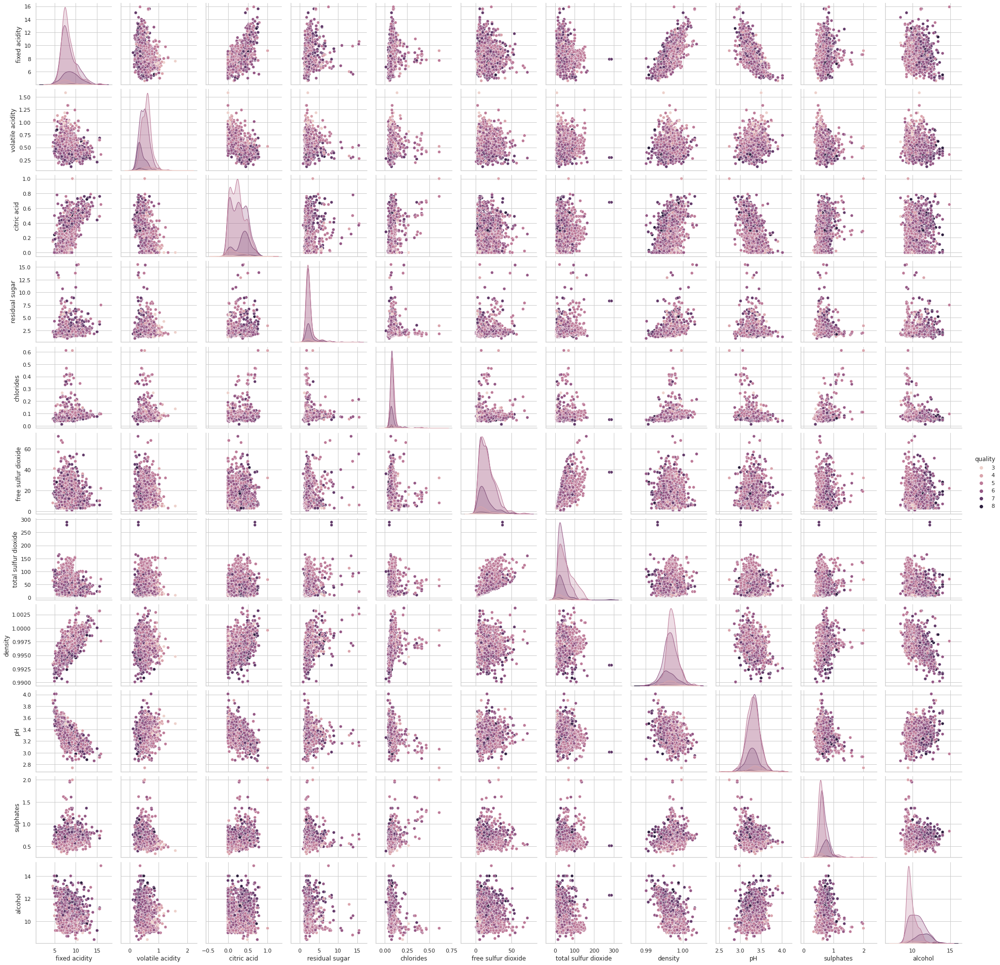

In [15]:
sns.pairplot(df, hue = 'quality')
plt.show()

In [16]:
target = df["quality"]

Index(['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar',
       'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density',
       'pH', 'sulphates', 'alcohol'],
      dtype='object')

In [17]:
features = df[ df.columns[df.columns != "quality"] ]

In [20]:
from sklearn.svm import SVC

classifier = SVC(n_jobs=-1)

params = {
    'C': [0.1,0.8],
    'kernel':['linear', 'rbf'],
    'gamma' :[0.1,0.8]
}

scoring = ["accuracy", "f1_samples","roc_auc"]
results, best_params = score_model(
    model=classifier, 
    params=params, 
    features=features, 
    target=target, 
    scoring=scoring,
    refit="f1_samples"
)

KeyboardInterrupt: 

In [19]:
min_features_to_select = 5  
# Set number of folds
tscv = TimeSeriesSplit(test_size=100)
# cv = RepeatedKFold(n_splits=5, n_repeats=1, random_state=1) 
# Set cross-validation process
rfecv = RFECV(estimator=regr, step=1, cv=tscv,
              scoring='neg_mean_absolute_error',
              min_features_to_select=min_features_to_select, n_jobs=-1)
# Fit the model
rfecv.fit(features, target)
print("Optimal number of features : %d" % rfecv.n_features_)

most_relevent_cols = features.columns[np.where(rfecv.support_ == True)]
print("Most relevant features are: ")
print(most_relevent_cols.values)

NameError: name 'TimeSeriesSplit' is not defined